## Install and imports

In [1]:
import pandas as pd
import seaborn as sns

from datetime import datetime

# Data downloading and prepocessing

In [5]:
df_price= pd.read_csv('Elspotprices.csv', sep = ';')

In [6]:
df_weather = pd.read_csv('weather.csv', skiprows= 3)

In [7]:
df_price.shape

(70128, 5)

In [8]:
df_weather.shape

(70128, 8)

In [9]:
df_price.head()

,HourUTC,HourDK,PriceArea,SpotPriceDKK,SpotPriceEUR
0,2014-12-31 23:00,2015-01-01 00:00,DK1,"186,220001","25,020000"
1,2015-01-01 00:00,2015-01-01 01:00,DK1,"136,130005","18,290001"
2,2015-01-01 01:00,2015-01-01 02:00,DK1,"119,389999","16,040001"
3,2015-01-01 02:00,2015-01-01 03:00,DK1,"108,669998","14,600000"
4,2015-01-01 03:00,2015-01-01 04:00,DK1,"111,269997","14,950000"


In [10]:
df_price.drop('HourUTC', inplace = True, axis = 1)

In [11]:
df_price.head()

,HourDK,PriceArea,SpotPriceDKK,SpotPriceEUR
0,2015-01-01 00:00,DK1,"186,220001","25,020000"
1,2015-01-01 01:00,DK1,"136,130005","18,290001"
2,2015-01-01 02:00,DK1,"119,389999","16,040001"
3,2015-01-01 03:00,DK1,"108,669998","14,600000"
4,2015-01-01 04:00,DK1,"111,269997","14,950000"


In [12]:
df_price['HourDK']

0        2015-01-01 00:00
1        2015-01-01 01:00
2        2015-01-01 02:00
3        2015-01-01 03:00
4        2015-01-01 04:00
               ...       
70123    2022-12-31 19:00
70124    2022-12-31 20:00
70125    2022-12-31 21:00
70126    2022-12-31 22:00
70127    2022-12-31 23:00
Name: HourDK, Length: 70128, dtype: object

In [13]:
df_weather.head(5)

,time,temperature_2m (°C),relativehumidity_2m (%),precipitation (mm),direct_radiation (W/m²),diffuse_radiation (W/m²),windspeed_10m (m/s),windspeed_100m (m/s)
0,2015-01-01T00:00,4.7,94,0.0,0.0,0.0,4.61,8.34
1,2015-01-01T01:00,4.7,94,0.0,0.0,0.0,4.84,8.63
2,2015-01-01T02:00,4.8,95,0.0,0.0,0.0,4.97,8.72
3,2015-01-01T03:00,4.9,95,0.0,0.0,0.0,5.06,8.90
4,2015-01-01T04:00,5.0,94,0.0,0.0,0.0,5.11,8.99


In [14]:
df_weather['time']

0        2015-01-01T00:00
1        2015-01-01T01:00
2        2015-01-01T02:00
3        2015-01-01T03:00
4        2015-01-01T04:00
               ...       
70123    2022-12-31T19:00
70124    2022-12-31T20:00
70125    2022-12-31T21:00
70126    2022-12-31T22:00
70127    2022-12-31T23:00
Name: time, Length: 70128, dtype: object

In [15]:

#define the input format and output format 
input_format = '%Y-%m-%dT%H:%M'
output_format = '%Y-%m-%d %H:%M'

In [16]:
# convert date format
df_weather['time'] = df_weather['time'].apply(lambda x: datetime.strptime(x, input_format).strftime(output_format))

print(df_weather)

                   time  temperature_2m (°C)  relativehumidity_2m (%)  \
0      2015-01-01 00:00                  4.7                       94   
1      2015-01-01 01:00                  4.7                       94   
2      2015-01-01 02:00                  4.8                       95   
3      2015-01-01 03:00                  4.9                       95   
4      2015-01-01 04:00                  5.0                       94   
...                 ...                  ...                      ...   
70123  2022-12-31 19:00                  5.8                       86   
70124  2022-12-31 20:00                  5.7                       86   
70125  2022-12-31 21:00                  4.2                       86   
70126  2022-12-31 22:00                  3.7                       87   
70127  2022-12-31 23:00                  3.6                       87   

       precipitation (mm)  direct_radiation (W/m²)  diffuse_radiation (W/m²)  \
0                     0.0                  

In [17]:
df_weather['time']

0        2015-01-01 00:00
1        2015-01-01 01:00
2        2015-01-01 02:00
3        2015-01-01 03:00
4        2015-01-01 04:00
               ...       
70123    2022-12-31 19:00
70124    2022-12-31 20:00
70125    2022-12-31 21:00
70126    2022-12-31 22:00
70127    2022-12-31 23:00
Name: time, Length: 70128, dtype: object

In [18]:
df_price['HourDK']

0        2015-01-01 00:00
1        2015-01-01 01:00
2        2015-01-01 02:00
3        2015-01-01 03:00
4        2015-01-01 04:00
               ...       
70123    2022-12-31 19:00
70124    2022-12-31 20:00
70125    2022-12-31 21:00
70126    2022-12-31 22:00
70127    2022-12-31 23:00
Name: HourDK, Length: 70128, dtype: object

In [19]:
len(df_weather['time'].isin(df_price['HourDK']))
# both has same values and shape 
# ready to merge

70128

In [20]:
# merging on time 
df_merge= pd.merge(df_price, df_weather, on=df_weather['time'])

In [21]:
df_merge.head(5)

,key_0,HourDK,PriceArea,SpotPriceDKK,SpotPriceEUR,time,temperature_2m (°C),relativehumidity_2m (%),precipitation (mm),direct_radiation (W/m²),diffuse_radiation (W/m²),windspeed_10m (m/s),windspeed_100m (m/s)
0,2015-01-01 00:00,2015-01-01 00:00,DK1,"186,220001","25,020000",2015-01-01 00:00,4.7,94,0.0,0.0,0.0,4.61,8.34
1,2015-01-01 01:00,2015-01-01 01:00,DK1,"136,130005","18,290001",2015-01-01 01:00,4.7,94,0.0,0.0,0.0,4.84,8.63
2,2015-01-01 02:00,2015-01-01 02:00,DK1,"119,389999","16,040001",2015-01-01 02:00,4.8,95,0.0,0.0,0.0,4.97,8.72
3,2015-01-01 03:00,2015-01-01 03:00,DK1,"108,669998","14,600000",2015-01-01 03:00,4.9,95,0.0,0.0,0.0,5.06,8.90
4,2015-01-01 04:00,2015-01-01 04:00,DK1,"111,269997","14,950000",2015-01-01 04:00,5.0,94,0.0,0.0,0.0,5.11,8.99


In [22]:
# removing columns
df_merge.drop(['key_0','HourDK'], inplace = True, axis = 1)

In [23]:
df_merge.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 70128 entries, 0 to 70127
Data columns (total 11 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   PriceArea                 70128 non-null  object 
 1   SpotPriceDKK              70128 non-null  object 
 2   SpotPriceEUR              70128 non-null  object 
 3   time                      70128 non-null  object 
 4   temperature_2m (°C)       70128 non-null  float64
 5   relativehumidity_2m (%)   70128 non-null  int64  
 6   precipitation (mm)        70128 non-null  float64
 7   direct_radiation (W/m²)   70128 non-null  float64
 8   diffuse_radiation (W/m²)  70128 non-null  float64
 9   windspeed_10m (m/s)       70128 non-null  float64
 10  windspeed_100m (m/s)      70128 non-null  float64
dtypes: float64(6), int64(1), object(4)
memory usage: 6.4+ MB


In [24]:
df_merge.shape


(70128, 11)

In [25]:
df_merge.head(5)

,PriceArea,SpotPriceDKK,SpotPriceEUR,time,temperature_2m (°C),relativehumidity_2m (%),precipitation (mm),direct_radiation (W/m²),diffuse_radiation (W/m²),windspeed_10m (m/s),windspeed_100m (m/s)
0,DK1,"186,220001","25,020000",2015-01-01 00:00,4.7,94,0.0,0.0,0.0,4.61,8.34
1,DK1,"136,130005","18,290001",2015-01-01 01:00,4.7,94,0.0,0.0,0.0,4.84,8.63
2,DK1,"119,389999","16,040001",2015-01-01 02:00,4.8,95,0.0,0.0,0.0,4.97,8.72
3,DK1,"108,669998","14,600000",2015-01-01 03:00,4.9,95,0.0,0.0,0.0,5.06,8.90
4,DK1,"111,269997","14,950000",2015-01-01 04:00,5.0,94,0.0,0.0,0.0,5.11,8.99


In [26]:
df_merge.dtypes

PriceArea                    object
SpotPriceDKK                 object
SpotPriceEUR                 object
time                         object
temperature_2m (°C)         float64
relativehumidity_2m (%)       int64
precipitation (mm)          float64
direct_radiation (W/m²)     float64
diffuse_radiation (W/m²)    float64
windspeed_10m (m/s)         float64
windspeed_100m (m/s)        float64
dtype: object

In [27]:
# changing obj to float
df_merge['SpotPriceDKK'] = df_merge['SpotPriceDKK'].str.replace(',', '.').astype(float)

In [29]:
df_merge.dtypes

PriceArea                    object
SpotPriceDKK                float64
SpotPriceEUR                 object
time                         object
temperature_2m (°C)         float64
relativehumidity_2m (%)       int64
precipitation (mm)          float64
direct_radiation (W/m²)     float64
diffuse_radiation (W/m²)    float64
windspeed_10m (m/s)         float64
windspeed_100m (m/s)        float64
dtype: object

In [30]:
df_merge['Price_per_KWh'] = df_merge['SpotPriceDKK'] / 1000
df_merge

,PriceArea,SpotPriceDKK,SpotPriceEUR,time,temperature_2m (°C),relativehumidity_2m (%),precipitation (mm),direct_radiation (W/m²),diffuse_radiation (W/m²),windspeed_10m (m/s),windspeed_100m (m/s),Price_per_KWh
0,DK1,186.220001,"25,020000",2015-01-01 00:00,4.7,94,0.0,0.0,0.0,4.61,8.34,0.18622
1,DK1,136.130005,"18,290001",2015-01-01 01:00,4.7,94,0.0,0.0,0.0,4.84,8.63,0.13613
2,DK1,119.389999,"16,040001",2015-01-01 02:00,4.8,95,0.0,0.0,0.0,4.97,8.72,0.11939
3,DK1,108.669998,"14,600000",2015-01-01 03:00,4.9,95,0.0,0.0,0.0,5.06,8.90,0.10867
4,DK1,111.269997,"14,950000",2015-01-01 04:00,5.0,94,0.0,0.0,0.0,5.11,8.99,0.11127
...,...,...,...,...,...,...,...,...,...,...,...,...
70123,DK1,498.329987,"67,010002",2022-12-31 19:00,5.8,86,0.0,0.0,0.0,2.72,5.24,0.49833
70124,DK1,301.190002,"40,500000",2022-12-31 20:00,5.7,86,0.0,0.0,0.0,3.28,6.31,0.30119
70125,DK1,110.730003,"14,890000",2022-12-31 21:00,4.2,86,0.0,0.0,0.0,3.05,6.40,0.11073
70126,DK1,73.919998,"9,940000",2022-12-31 22:00,3.7,87,0.0,0.0,0.0,2.92,6.16,0.07392


# Exploratory data Analysis(EDA)

<AxesSubplot:>

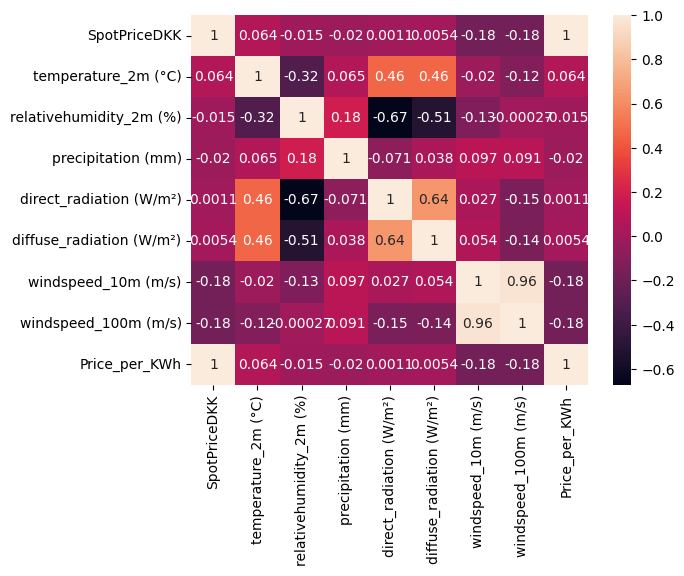

In [31]:
import seaborn as sns

sns.heatmap(df_merge.corr(method = 'pearson'), annot = True)

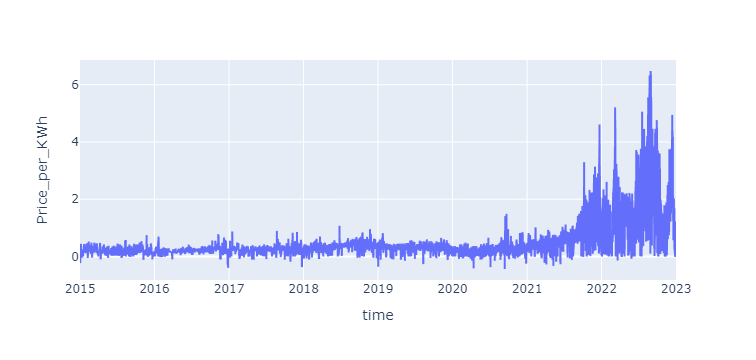

In [32]:
import plotly.express as px

fig = px.line(df_merge, x='time', y='Price_per_KWh')
fig.show()

The price of electricity seems stable till 2021, after the prices seems more changing maybe because of other factors like (war)



In [33]:
df_merge.describe()

,SpotPriceDKK,temperature_2m (°C),relativehumidity_2m (%),precipitation (mm),direct_radiation (W/m²),diffuse_radiation (W/m²),windspeed_10m (m/s),windspeed_100m (m/s),Price_per_KWh
count,70128.000000,70128.000000,70128.000000,70128.000000,70128.000000,70128.000000,70128.000000,70128.000000,70128.000000
mean,459.802478,9.353156,80.189111,0.085214,75.468073,48.119382,4.299606,7.226438,0.459802
std,631.857481,6.352313,12.890545,0.308531,144.582754,67.793753,1.994026,3.105812,0.631857
min,-437.489990,-9.800000,30.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.437490
25%,182.435001,4.400000,72.000000,0.000000,0.000000,0.000000,2.760000,5.020000,0.182435
50%,260.970001,9.100000,83.000000,0.000000,0.000000,4.000000,4.110000,7.070000,0.260970
75%,400.559998,14.300000,90.000000,0.000000,76.000000,86.000000,5.600000,9.230000,0.400560
max,6478.240234,28.500000,100.000000,9.200000,740.000000,407.000000,14.900000,23.560000,6.478240


In [34]:
df_merge.sort_values('Price_per_KWh', ascending = False).head(3)
# highest prices 

,PriceArea,SpotPriceDKK,SpotPriceEUR,time,temperature_2m (°C),relativehumidity_2m (%),precipitation (mm),direct_radiation (W/m²),diffuse_radiation (W/m²),windspeed_10m (m/s),windspeed_100m (m/s),Price_per_KWh
67146,DK1,6478.240234,"871,000000",2022-08-29 18:00,17.5,57,0.0,264.0,76.0,4.18,6.02,6.47824
67147,DK1,6403.040039,"860,890015",2022-08-29 19:00,17.1,60,0.0,142.0,58.0,3.32,5.20,6.40304
67170,DK1,6363.330078,"855,460022",2022-08-30 18:00,18.2,57,0.0,247.0,76.0,3.30,4.66,6.36333


In [35]:
df_merge.sort_values('Price_per_KWh', ascending = True).head(3)
# lowest prices 
# supply more than demand == negative price

,PriceArea,SpotPriceDKK,SpotPriceEUR,time,temperature_2m (°C),relativehumidity_2m (%),precipitation (mm),direct_radiation (W/m²),diffuse_radiation (W/m²),windspeed_10m (m/s),windspeed_100m (m/s),Price_per_KWh
49980,DK1,-437.489990,"-58,799999",2020-09-13 12:00,14.8,85,0.0,2.0,84.0,4.84,8.18,-0.43749
46310,DK1,-416.260010,"-55,770000",2020-04-13 14:00,7.7,31,0.0,595.0,111.0,6.08,8.52,-0.41626
17427,DK1,-398.609985,"-53,619999",2016-12-27 03:00,6.6,64,0.0,0.0,0.0,13.15,21.11,-0.39861


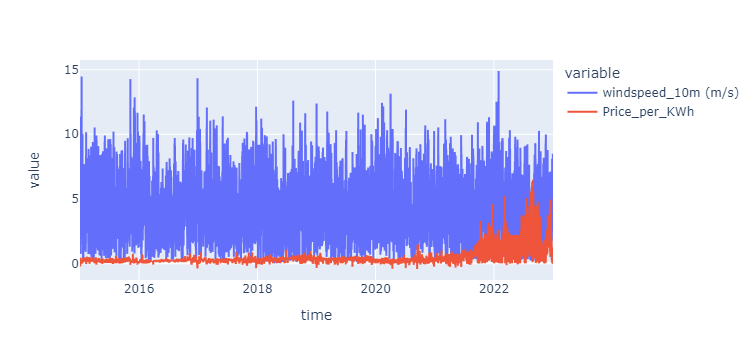

In [41]:
import plotly.express as px

fig = px.line(df_merge, x='time', y=['windspeed_10m (m/s)', 'Price_per_KWh'])
fig.show()

In [37]:
df_merge.dtypes

PriceArea                    object
SpotPriceDKK                float64
SpotPriceEUR                 object
time                         object
temperature_2m (°C)         float64
relativehumidity_2m (%)       int64
precipitation (mm)          float64
direct_radiation (W/m²)     float64
diffuse_radiation (W/m²)    float64
windspeed_10m (m/s)         float64
windspeed_100m (m/s)        float64
Price_per_KWh               float64
dtype: object

In [38]:
scaled_data= df_merge[['time', 'Price_per_KWh', 'temperature_2m (°C)' , 'relativehumidity_2m (%)', 'precipitation (mm)', 'direct_radiation (W/m²)', 'windspeed_10m (m/s)','windspeed_100m (m/s)']]
scaled_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 70128 entries, 0 to 70127
Data columns (total 8 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   time                     70128 non-null  object 
 1   Price_per_KWh            70128 non-null  float64
 2   temperature_2m (°C)      70128 non-null  float64
 3   relativehumidity_2m (%)  70128 non-null  int64  
 4   precipitation (mm)       70128 non-null  float64
 5   direct_radiation (W/m²)  70128 non-null  float64
 6   windspeed_10m (m/s)      70128 non-null  float64
 7   windspeed_100m (m/s)     70128 non-null  float64
dtypes: float64(6), int64(1), object(1)
memory usage: 4.8+ MB


In [39]:
scaled_data['time']

0        2015-01-01 00:00
1        2015-01-01 01:00
2        2015-01-01 02:00
3        2015-01-01 03:00
4        2015-01-01 04:00
               ...       
70123    2022-12-31 19:00
70124    2022-12-31 20:00
70125    2022-12-31 21:00
70126    2022-12-31 22:00
70127    2022-12-31 23:00
Name: time, Length: 70128, dtype: object